# Retail Store Analysis and Inventory Level Analysis of Dataset

# 1. Understanding the Dataset

In [3]:
# import the libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
# Loading the data
df=pd.read_csv("retail_store_inventory.csv")

In [5]:
# data accessing
print(df)

             Date Store ID Product ID     Category Region  Inventory Level  \
0      2022-01-01     S001      P0001    Groceries  North              231   
1      2022-01-01     S001      P0002         Toys  South              204   
2      2022-01-01     S001      P0003         Toys   West              102   
3      2022-01-01     S001      P0004         Toys  North              469   
4      2022-01-01     S001      P0005  Electronics   East              166   
...           ...      ...        ...          ...    ...              ...   
73095  2024-01-01     S005      P0016    Furniture   East               96   
73096  2024-01-01     S005      P0017         Toys  North              313   
73097  2024-01-01     S005      P0018     Clothing   West              278   
73098  2024-01-01     S005      P0019         Toys   East              374   
73099  2024-01-01     S005      P0020    Groceries   East              117   

       Units Sold  Units Ordered  Demand Forecast  Price  Disco

# Inspect Data

In [7]:
# getting the first five rows of data
df.head()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Autumn
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Autumn
2,2022-01-01,S001,P0003,Toys,West,102,65,51,74.02,27.99,10,Sunny,1,31.32,Summer
3,2022-01-01,S001,P0004,Toys,North,469,61,164,62.18,32.72,10,Cloudy,1,34.74,Autumn
4,2022-01-01,S001,P0005,Electronics,East,166,14,135,9.26,73.64,0,Sunny,0,68.95,Summer


In [8]:
# getting the last five row of data
df.tail()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
73095,2024-01-01,S005,P0016,Furniture,East,96,8,127,18.46,73.73,20,Snowy,0,72.45,Winter
73096,2024-01-01,S005,P0017,Toys,North,313,51,101,48.43,82.57,10,Cloudy,0,83.78,Autumn
73097,2024-01-01,S005,P0018,Clothing,West,278,36,151,39.65,11.11,10,Rainy,0,10.91,Winter
73098,2024-01-01,S005,P0019,Toys,East,374,264,21,270.52,53.14,20,Rainy,0,55.80,Spring
73099,2024-01-01,S005,P0020,Groceries,East,117,6,165,2.33,78.39,20,Rainy,1,79.52,Spring


In [9]:
# random sample of data
df.sample

<bound method NDFrame.sample of              Date Store ID Product ID     Category Region  Inventory Level  \
0      2022-01-01     S001      P0001    Groceries  North              231   
1      2022-01-01     S001      P0002         Toys  South              204   
2      2022-01-01     S001      P0003         Toys   West              102   
3      2022-01-01     S001      P0004         Toys  North              469   
4      2022-01-01     S001      P0005  Electronics   East              166   
...           ...      ...        ...          ...    ...              ...   
73095  2024-01-01     S005      P0016    Furniture   East               96   
73096  2024-01-01     S005      P0017         Toys  North              313   
73097  2024-01-01     S005      P0018     Clothing   West              278   
73098  2024-01-01     S005      P0019         Toys   East              374   
73099  2024-01-01     S005      P0020    Groceries   East              117   

       Units Sold  Units Ordere

In [10]:
# the columns in dataset
df.columns

Index(['Date', 'Store ID', 'Product ID', 'Category', 'Region',
       'Inventory Level', 'Units Sold', 'Units Ordered', 'Demand Forecast',
       'Price', 'Discount', 'Weather Condition', 'Holiday/Promotion',
       'Competitor Pricing', 'Seasonality'],
      dtype='object')

In [11]:
# shape of dataset
df.shape

(73100, 15)

In [12]:
# describe the data
print(df.describe())

       Inventory Level    Units Sold  Units Ordered  Demand Forecast  \
count     73100.000000  73100.000000   73100.000000     73100.000000   
mean        274.469877    136.464870     110.004473       141.494720   
std         129.949514    108.919406      52.277448       109.254076   
min          50.000000      0.000000      20.000000        -9.990000   
25%         162.000000     49.000000      65.000000        53.670000   
50%         273.000000    107.000000     110.000000       113.015000   
75%         387.000000    203.000000     155.000000       208.052500   
max         500.000000    499.000000     200.000000       518.550000   

              Price      Discount  Holiday/Promotion  Competitor Pricing  
count  73100.000000  73100.000000       73100.000000        73100.000000  
mean      55.135108     10.009508           0.497305           55.146077  
std       26.021945      7.083746           0.499996           26.191408  
min       10.000000      0.000000           0.00000

In [13]:
# statastically describe the data
df.describe()

,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Holiday/Promotion,Competitor Pricing
count,73100.000000,73100.000000,73100.000000,73100.000000,73100.000000,73100.000000,73100.000000,73100.000000
mean,274.469877,136.464870,110.004473,141.494720,55.135108,10.009508,0.497305,55.146077
std,129.949514,108.919406,52.277448,109.254076,26.021945,7.083746,0.499996,26.191408
min,50.000000,0.000000,20.000000,-9.990000,10.000000,0.000000,0.000000,5.030000
25%,162.000000,49.000000,65.000000,53.670000,32.650000,5.000000,0.000000,32.680000
50%,273.000000,107.000000,110.000000,113.015000,55.050000,10.000000,0.000000,55.010000
75%,387.000000,203.000000,155.000000,208.052500,77.860000,15.000000,1.000000,77.820000
max,500.000000,499.000000,200.000000,518.550000,100.000000,20.000000,1.000000,104.940000


# Data Cleaning Process

In [15]:
# finding the null values in dataset
df.isnull()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73095,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
73096,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
73097,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
73098,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [16]:
df.isnull().sum()

Date                  0
Store ID              0
Product ID            0
Category              0
Region                0
Inventory Level       0
Units Sold            0
Units Ordered         0
Demand Forecast       0
Price                 0
Discount              0
Weather Condition     0
Holiday/Promotion     0
Competitor Pricing    0
Seasonality           0
dtype: int64

In [17]:
# information of dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 73100 entries, 0 to 73099
Data columns (total 15 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Date                73100 non-null  object 
 1   Store ID            73100 non-null  object 
 2   Product ID          73100 non-null  object 
 3   Category            73100 non-null  object 
 4   Region              73100 non-null  object 
 5   Inventory Level     73100 non-null  int64  
 6   Units Sold          73100 non-null  int64  
 7   Units Ordered       73100 non-null  int64  
 8   Demand Forecast     73100 non-null  float64
 9   Price               73100 non-null  float64
 10  Discount            73100 non-null  int64  
 11  Weather Condition   73100 non-null  object 
 12  Holiday/Promotion   73100 non-null  int64  
 13  Competitor Pricing  73100 non-null  float64
 14  Seasonality         73100 non-null  object 
dtypes: float64(3), int64(5), object(7)
memory usage: 8.4+

In [18]:
 # removing the duplicates in dataset
df.drop_duplicates()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Autumn
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Autumn
2,2022-01-01,S001,P0003,Toys,West,102,65,51,74.02,27.99,10,Sunny,1,31.32,Summer
3,2022-01-01,S001,P0004,Toys,North,469,61,164,62.18,32.72,10,Cloudy,1,34.74,Autumn
4,2022-01-01,S001,P0005,Electronics,East,166,14,135,9.26,73.64,0,Sunny,0,68.95,Summer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73095,2024-01-01,S005,P0016,Furniture,East,96,8,127,18.46,73.73,20,Snowy,0,72.45,Winter
73096,2024-01-01,S005,P0017,Toys,North,313,51,101,48.43,82.57,10,Cloudy,0,83.78,Autumn
73097,2024-01-01,S005,P0018,Clothing,West,278,36,151,39.65,11.11,10,Rainy,0,10.91,Winter
73098,2024-01-01,S005,P0019,Toys,East,374,264,21,270.52,53.14,20,Rainy,0,55.80,Spring


In [19]:
# check the data is not null
df.notnull()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
0,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
1,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
2,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
3,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
4,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73095,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
73096,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
73097,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True
73098,True,True,True,True,True,True,True,True,True,True,True,True,True,True,True


In [20]:
# drop the nan values in dataset
df.dropna()

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Autumn
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Autumn
2,2022-01-01,S001,P0003,Toys,West,102,65,51,74.02,27.99,10,Sunny,1,31.32,Summer
3,2022-01-01,S001,P0004,Toys,North,469,61,164,62.18,32.72,10,Cloudy,1,34.74,Autumn
4,2022-01-01,S001,P0005,Electronics,East,166,14,135,9.26,73.64,0,Sunny,0,68.95,Summer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73095,2024-01-01,S005,P0016,Furniture,East,96,8,127,18.46,73.73,20,Snowy,0,72.45,Winter
73096,2024-01-01,S005,P0017,Toys,North,313,51,101,48.43,82.57,10,Cloudy,0,83.78,Autumn
73097,2024-01-01,S005,P0018,Clothing,West,278,36,151,39.65,11.11,10,Rainy,0,10.91,Winter
73098,2024-01-01,S005,P0019,Toys,East,374,264,21,270.52,53.14,20,Rainy,0,55.80,Spring


# Data selection and fitering

1. Importance of Data Filtering and Selection
Enhances Data Quality
Raw datasets often contain irrelevant, redundant, or noisy data, which can skew analysis and lead to misleading results. Filtering removes such anomalies, ensuring a clean dataset.

Focuses Analysis
Not all data points contribute equally to the analysis. For instance, a dataset covering global sales might require filtering to focus on specific regions or product categories.

Improves Performance
Large datasets with unnecessary records can slow down computation. Filtering reduces dataset size, improving computational efficiency without compromising the quality of insights.

Enables Targeted Insights
By isolating specific subsets of data, filtering allows targeted analysis. For example:

Analyzing sales performance during a holiday season.
Evaluating inventory levels for high-demand products.
2. Key Concepts in Data Filtering
1. Conditional Filtering
Data is filtered based on logical conditions or rules. For example:

Sales greater than a threshold: Sales > 1000.
Inventory below a reorder point: Inventory Level < Restocking Threshold.
2. Subset Selection
Only specific columns (features) or rows (records) are selected for analysis. Examples include:

Selecting columns like Sales Volume, Revenue, and Category.
Isolating records for specific stores or time periods.
3. Group-Based Filtering
Filtering involves grouping data by categories and applying conditions within each group. For example:

Extracting top-selling products in each region.
Identifying understocked products within each store.
4. Temporal Filtering
Datasets with time-based information can be filtered for specific periods. For example:

Focusing on sales data for a particular year or quarter.
Analyzing inventory turnover during holiday seasons.
5. Filtering by Missing or Null Values
Records with missing data in critical columns (e.g., Sales Volume) are often filtered out or imputed, depending on the analysis requirements.

3. Methods for Data Filtering and Selection
1. Manual Filtering
Manually inspecting and removing irrelevant or incorrect data. While feasible for small datasets, it’s impractical for large datasets due to time and accuracy constraints.

2. Programmatic Filtering
Using tools like Python, R, or SQL to automate filtering. Examples include:

In [23]:
# selecting price column
print("mean of price =",df['Price'].mean())
print("median of price =",df['Price'].median())
print("mode of price =",df['Price'].mode())

mean of price = 55.13510820793434
median of price = 55.05
mode of price = 0    31.2
Name: Price, dtype: float64


In [24]:
df[['Price','Discount']]

,Price,Discount
0,33.50,20
1,63.01,20
2,27.99,10
3,32.72,10
4,73.64,0
...,...,...
73095,73.73,20
73096,82.57,10
73097,11.11,10
73098,53.14,20


In [25]:
# filter the column based on condition
df[df['Discount']>19]

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
0,2022-01-01,S001,P0001,Groceries,North,231,127,55,135.47,33.50,20,Rainy,0,29.69,Autumn
1,2022-01-01,S001,P0002,Toys,South,204,150,66,144.04,63.01,20,Sunny,0,66.16,Autumn
11,2022-01-01,S001,P0012,Clothing,West,66,24,70,26.75,58.25,20,Snowy,0,62.21,Spring
16,2022-01-01,S001,P0017,Toys,West,318,246,177,255.37,21.07,20,Sunny,0,16.49,Winter
20,2022-01-01,S002,P0001,Groceries,South,343,104,144,112.55,32.80,20,Sunny,1,30.78,Spring
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73079,2024-01-01,S004,P0020,Toys,West,249,243,115,248.08,32.87,20,Sunny,0,31.39,Spring
73085,2024-01-01,S005,P0006,Furniture,North,491,173,100,175.40,71.30,20,Snowy,1,68.90,Winter
73095,2024-01-01,S005,P0016,Furniture,East,96,8,127,18.46,73.73,20,Snowy,0,72.45,Winter
73098,2024-01-01,S005,P0019,Toys,East,374,264,21,270.52,53.14,20,Rainy,0,55.80,Spring


In [26]:
# filter the column based on condition
df[df['Price']>90]

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
7,2022-01-01,S001,P0008,Clothing,North,380,312,54,329.73,97.99,5,Cloudy,0,100.09,Spring
14,2022-01-01,S001,P0015,Clothing,North,379,369,154,363.46,92.99,15,Snowy,0,95.80,Winter
26,2022-01-01,S002,P0007,Groceries,West,460,393,70,401.48,91.13,5,Sunny,0,93.33,Summer
33,2022-01-01,S002,P0014,Electronics,East,465,359,77,370.36,91.28,20,Cloudy,0,90.85,Summer
44,2022-01-01,S003,P0005,Clothing,West,438,325,20,330.92,97.95,20,Sunny,0,93.54,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73027,2024-01-01,S002,P0008,Furniture,North,218,43,144,51.52,90.38,10,Sunny,0,94.87,Autumn
73030,2024-01-01,S002,P0011,Groceries,West,156,39,166,53.05,99.13,5,Sunny,0,95.25,Autumn
73072,2024-01-01,S004,P0013,Electronics,West,113,6,67,10.72,90.89,5,Rainy,0,90.22,Autumn
73080,2024-01-01,S005,P0001,Toys,North,300,201,69,201.10,99.33,10,Cloudy,1,94.44,Winter


In [27]:
# fitering column based on condition
df[df['Competitor Pricing']>80]

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
7,2022-01-01,S001,P0008,Clothing,North,380,312,54,329.73,97.99,5,Cloudy,0,100.09,Spring
13,2022-01-01,S001,P0014,Clothing,West,193,12,187,6.80,78.11,0,Sunny,0,80.06,Spring
14,2022-01-01,S001,P0015,Clothing,North,379,369,154,363.46,92.99,15,Snowy,0,95.80,Winter
24,2022-01-01,S002,P0005,Toys,West,281,156,25,150.90,83.29,20,Rainy,0,80.64,Autumn
25,2022-01-01,S002,P0006,Furniture,North,492,250,168,242.57,85.59,20,Cloudy,0,86.82,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73084,2024-01-01,S005,P0005,Toys,South,372,154,143,150.53,96.72,0,Cloudy,1,97.84,Winter
73088,2024-01-01,S005,P0009,Furniture,North,319,211,31,209.03,87.70,0,Rainy,1,91.05,Autumn
73090,2024-01-01,S005,P0011,Groceries,North,156,121,156,137.12,86.09,0,Snowy,1,87.83,Summer
73094,2024-01-01,S005,P0015,Furniture,North,408,323,92,336.64,83.26,0,Sunny,0,80.96,Winter


In [28]:
df[['Inventory Level','Units Sold','Units Ordered','Demand Forecast','Price','Discount']]

,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount
0,231,127,55,135.47,33.50,20
1,204,150,66,144.04,63.01,20
2,102,65,51,74.02,27.99,10
3,469,61,164,62.18,32.72,10
4,166,14,135,9.26,73.64,0
...,...,...,...,...,...,...
73095,96,8,127,18.46,73.73,20
73096,313,51,101,48.43,82.57,10
73097,278,36,151,39.65,11.11,10
73098,374,264,21,270.52,53.14,20


In [29]:
df[['Category','Region','Weather Condition','Seasonality']]

,Category,Region,Weather Condition,Seasonality
0,Groceries,North,Rainy,Autumn
1,Toys,South,Sunny,Autumn
2,Toys,West,Sunny,Summer
3,Toys,North,Cloudy,Autumn
4,Electronics,East,Sunny,Summer
...,...,...,...,...
73095,Furniture,East,Snowy,Winter
73096,Toys,North,Cloudy,Autumn
73097,Clothing,West,Rainy,Winter
73098,Toys,East,Rainy,Spring


In [30]:
# fitering by dates 2022
df[df['Date']>'2022-01-01']

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
100,2022-01-02,S001,P0001,Groceries,West,116,81,104,92.94,27.95,10,Cloudy,0,30.89,Spring
101,2022-01-02,S001,P0002,Clothing,West,416,163,79,171.60,19.78,15,Cloudy,0,18.76,Spring
102,2022-01-02,S001,P0003,Clothing,South,488,464,163,463.12,70.99,10,Snowy,0,72.93,Summer
103,2022-01-02,S001,P0004,Groceries,East,248,116,107,133.92,49.56,5,Snowy,0,50.46,Summer
104,2022-01-02,S001,P0005,Electronics,East,238,200,40,204.30,23.76,15,Sunny,1,19.19,Summer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73095,2024-01-01,S005,P0016,Furniture,East,96,8,127,18.46,73.73,20,Snowy,0,72.45,Winter
73096,2024-01-01,S005,P0017,Toys,North,313,51,101,48.43,82.57,10,Cloudy,0,83.78,Autumn
73097,2024-01-01,S005,P0018,Clothing,West,278,36,151,39.65,11.11,10,Rainy,0,10.91,Winter
73098,2024-01-01,S005,P0019,Toys,East,374,264,21,270.52,53.14,20,Rainy,0,55.80,Spring


In [31]:
# fitering by dates 2023
df[df['Date']>'2023-01-01']

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
36600,2023-01-02,S001,P0001,Clothing,South,358,79,71,98.16,57.86,10,Rainy,0,61.61,Summer
36601,2023-01-02,S001,P0002,Toys,West,406,257,113,250.26,30.68,15,Sunny,0,32.61,Spring
36602,2023-01-02,S001,P0003,Clothing,South,55,41,84,34.12,93.69,5,Snowy,1,88.82,Spring
36603,2023-01-02,S001,P0004,Clothing,North,86,30,153,36.02,29.41,20,Sunny,1,28.21,Winter
36604,2023-01-02,S001,P0005,Groceries,South,420,385,178,382.15,97.63,5,Cloudy,0,94.85,Summer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73095,2024-01-01,S005,P0016,Furniture,East,96,8,127,18.46,73.73,20,Snowy,0,72.45,Winter
73096,2024-01-01,S005,P0017,Toys,North,313,51,101,48.43,82.57,10,Cloudy,0,83.78,Autumn
73097,2024-01-01,S005,P0018,Clothing,West,278,36,151,39.65,11.11,10,Rainy,0,10.91,Winter
73098,2024-01-01,S005,P0019,Toys,East,374,264,21,270.52,53.14,20,Rainy,0,55.80,Spring


In [32]:
# fitering by dates 2024
df[df['Date']>='2024-01-01']

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
73000,2024-01-01,S001,P0001,Toys,East,223,40,93,53.56,55.26,15,Rainy,0,59.37,Winter
73001,2024-01-01,S001,P0002,Furniture,West,217,99,73,101.47,44.84,10,Snowy,0,41.09,Winter
73002,2024-01-01,S001,P0003,Toys,East,69,64,191,76.85,21.94,5,Snowy,0,25.07,Spring
73003,2024-01-01,S001,P0004,Groceries,West,338,182,152,192.43,86.37,0,Cloudy,1,82.98,Spring
73004,2024-01-01,S001,P0005,Groceries,North,471,272,167,266.62,15.58,20,Snowy,0,20.04,Autumn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73095,2024-01-01,S005,P0016,Furniture,East,96,8,127,18.46,73.73,20,Snowy,0,72.45,Winter
73096,2024-01-01,S005,P0017,Toys,North,313,51,101,48.43,82.57,10,Cloudy,0,83.78,Autumn
73097,2024-01-01,S005,P0018,Clothing,West,278,36,151,39.65,11.11,10,Rainy,0,10.91,Winter
73098,2024-01-01,S005,P0019,Toys,East,374,264,21,270.52,53.14,20,Rainy,0,55.80,Spring


In [33]:
# selecting random sample
df.sample(5)

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
52408,2023-06-09,S001,P0009,Electronics,West,362,114,148,116.23,91.31,20,Snowy,0,90.49,Autumn
41921,2023-02-24,S002,P0002,Toys,South,82,37,190,55.00,95.41,20,Sunny,0,98.29,Summer
17152,2022-06-21,S003,P0013,Furniture,East,137,1,28,-3.86,44.69,0,Cloudy,0,47.72,Spring
19108,2022-07-11,S001,P0009,Electronics,South,426,81,173,77.08,65.30,20,Cloudy,0,60.72,Winter
45993,2023-04-05,S005,P0014,Clothing,West,291,98,139,106.66,35.52,15,Cloudy,1,38.06,Autumn


# Sorting of Data columns

In [35]:
# Sorting Data ascending
df.sort_values(['Demand Forecast','Price'],ascending=True)

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
18710,2022-07-07,S001,P0011,Groceries,South,190,0,87,-9.99,77.12,0,Cloudy,0,74.90,Winter
60554,2023-08-29,S003,P0015,Electronics,South,52,0,142,-9.97,19.30,5,Sunny,0,23.90,Summer
63263,2023-09-25,S004,P0004,Clothing,North,182,0,33,-9.79,62.77,15,Sunny,0,65.73,Spring
37289,2023-01-08,S005,P0010,Furniture,South,64,0,156,-9.67,19.54,20,Cloudy,0,16.12,Spring
19076,2022-07-10,S004,P0017,Furniture,West,220,0,184,-9.62,54.97,15,Cloudy,0,51.63,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
61648,2023-09-09,S003,P0009,Groceries,South,499,488,116,505.39,88.48,15,Snowy,1,90.66,Winter
4005,2022-02-10,S001,P0006,Clothing,East,491,489,138,506.37,71.79,20,Cloudy,1,68.56,Spring
71292,2023-12-14,S005,P0013,Groceries,East,498,494,37,506.37,80.53,10,Snowy,0,80.87,Winter
36571,2023-01-01,S004,P0012,Groceries,East,497,493,25,512.36,55.09,0,Cloudy,1,59.82,Spring


In [36]:
# Sorting Data ascending
df.sort_values(['Inventory Level','Price'],ascending=True)

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
2883,2022-01-29,S005,P0004,Toys,West,50,13,200,21.97,10.63,15,Rainy,1,13.25,Winter
4578,2022-02-15,S004,P0019,Toys,South,50,38,115,32.77,11.58,0,Cloudy,0,11.55,Autumn
35049,2022-12-17,S003,P0010,Toys,West,50,37,25,42.51,11.73,20,Cloudy,0,7.53,Summer
39172,2023-01-27,S004,P0013,Groceries,West,50,41,155,38.78,12.10,15,Snowy,0,14.99,Spring
21898,2022-08-07,S005,P0019,Electronics,West,50,39,120,58.05,12.16,5,Cloudy,0,9.28,Summer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54818,2023-07-03,S001,P0019,Clothing,North,500,50,55,63.02,98.97,0,Cloudy,0,100.69,Winter
38225,2023-01-18,S002,P0006,Clothing,East,500,103,185,106.25,99.48,0,Rainy,0,104.44,Spring
7509,2022-03-17,S001,P0010,Toys,North,500,110,184,129.79,99.52,20,Rainy,0,94.84,Spring
21993,2022-08-08,S005,P0014,Clothing,East,500,365,107,356.05,99.59,10,Cloudy,1,99.17,Spring


In [37]:
# cap Outliers to a specific range
df.sort_values(['Competitor Pricing'],ascending=True)

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
10170,2022-04-12,S004,P0011,Toys,East,402,158,41,159.71,10.02,5,Rainy,1,5.03,Autumn
20008,2022-07-20,S001,P0009,Toys,South,114,90,179,100.14,10.11,5,Cloudy,0,5.29,Winter
25965,2022-09-17,S004,P0006,Clothing,West,173,156,20,171.40,10.06,5,Sunny,0,5.31,Winter
72360,2023-12-25,S004,P0001,Furniture,East,73,57,106,60.74,10.29,10,Rainy,0,5.34,Autumn
1854,2022-01-19,S003,P0015,Clothing,North,95,49,151,62.48,10.28,15,Snowy,0,5.34,Summer
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13942,2022-05-20,S003,P0003,Electronics,West,212,100,196,98.14,99.80,5,Rainy,0,104.64,Winter
23394,2022-08-22,S005,P0015,Clothing,South,213,103,174,115.49,99.95,15,Sunny,1,104.74,Summer
26526,2022-09-23,S002,P0007,Clothing,East,168,12,92,24.59,99.82,20,Cloudy,1,104.81,Spring
50104,2023-05-17,S001,P0005,Groceries,East,359,145,138,145.90,99.94,0,Snowy,1,104.91,Summer


In [38]:
df.sort_values('Units Ordered')

,Date,Store ID,Product ID,Category,Region,Inventory Level,Units Sold,Units Ordered,Demand Forecast,Price,Discount,Weather Condition,Holiday/Promotion,Competitor Pricing,Seasonality
18219,2022-07-02,S001,P0020,Clothing,West,283,137,20,129.29,80.49,15,Sunny,1,82.01,Autumn
26743,2022-09-25,S003,P0004,Groceries,West,159,37,20,54.00,47.23,5,Sunny,0,51.34,Spring
65848,2023-10-21,S003,P0009,Furniture,West,469,452,20,450.21,35.99,15,Cloudy,0,35.59,Autumn
13333,2022-05-14,S002,P0014,Groceries,North,101,57,20,70.80,27.69,20,Sunny,1,30.70,Summer
20468,2022-07-24,S004,P0009,Groceries,North,182,29,20,31.25,95.31,0,Cloudy,1,91.73,Autumn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32344,2022-11-20,S003,P0005,Furniture,South,485,236,200,248.67,14.46,15,Sunny,1,19.23,Summer
46901,2023-04-15,S001,P0002,Clothing,West,495,262,200,273.73,16.48,5,Cloudy,0,16.24,Spring
60831,2023-09-01,S002,P0012,Furniture,East,313,288,200,288.87,61.18,15,Rainy,0,60.60,Spring
41566,2023-02-20,S004,P0007,Furniture,South,391,264,200,278.82,75.17,10,Cloudy,1,79.14,Spring


# Creating the pivot Table

In [40]:
df.pivot_table(index='Product ID',values='Price',aggfunc='sum')

,Price
Product ID,
P0001,199370.49
P0002,202003.54
P0003,200607.45
P0004,202994.92
P0005,201111.22
P0006,200174.91
P0007,200725.00
P0008,202302.18
P0009,201596.04


In [41]:
df.pivot_table(index='Store ID',values='Discount',aggfunc='sum')

,Discount
Store ID,
S001,145055
S002,146815
S003,147740
S004,146285
S005,145800


In [42]:
df.pivot_table(index='Store ID',values='Demand Forecast',aggfunc='sum')

,Demand Forecast
Store ID,
S001,2048918.37
S002,2061039.81
S003,2095541.71
S004,2052657.73
S005,2085106.42


# Data Visualization

Data visualization is the graphical representation of information and data through visual elements like charts, graphs, and maps. It is an essential component of data analysis, allowing complex datasets to be interpreted easily and effectively. By transforming raw data into visual formats, data visualization helps uncover patterns, trends, and insights that might otherwise remain hidden in numerical data.


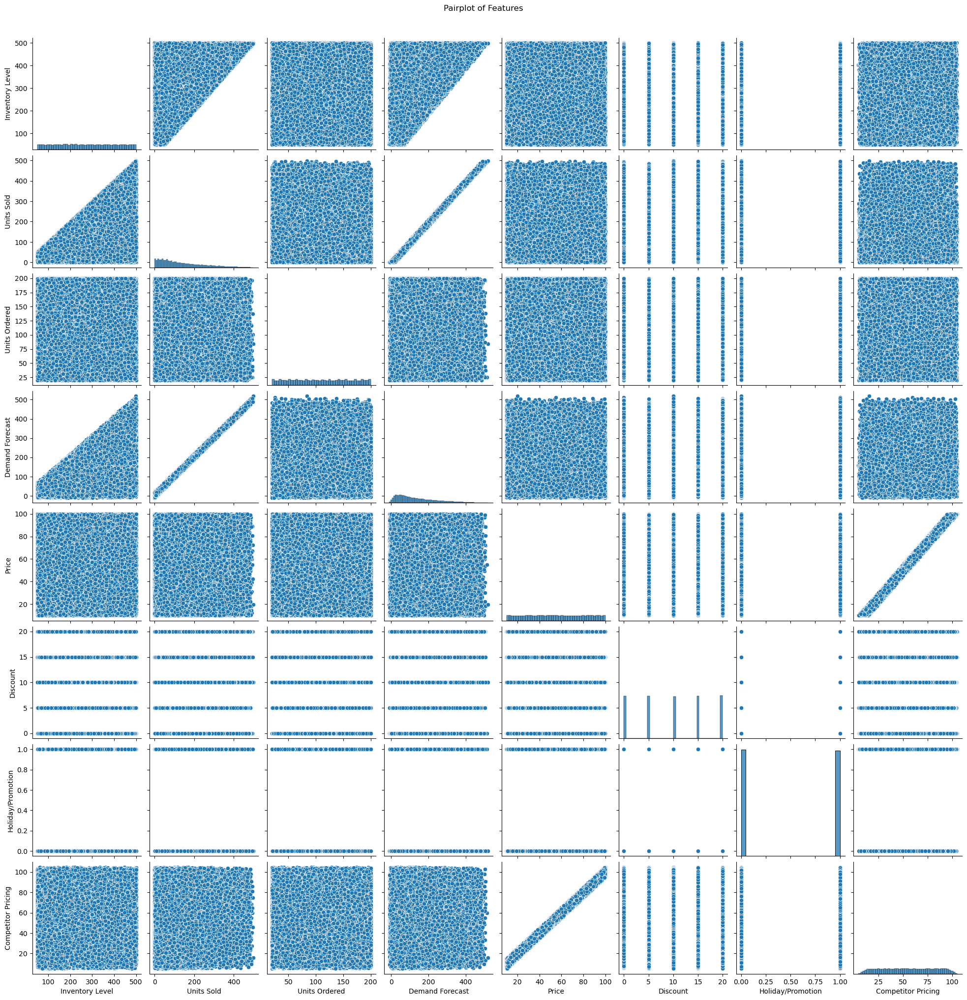

In [45]:
# Pair Plot
sns.pairplot(df)
plt.suptitle('Pairplot of Features', y=1.02)
plt.show()

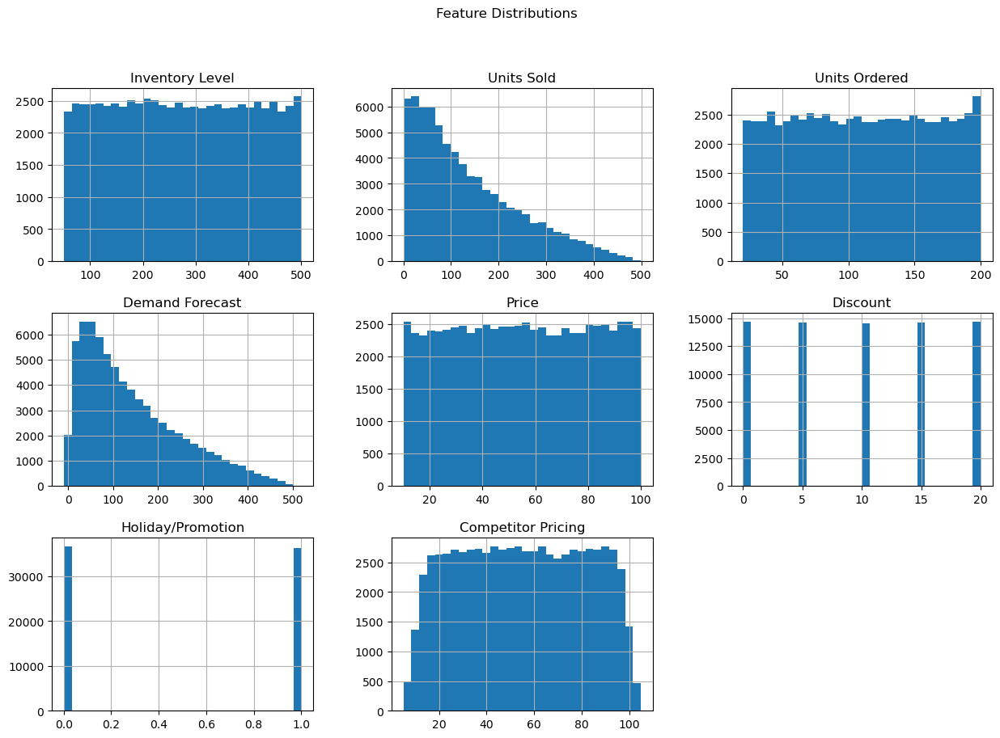

In [46]:
# Plot distributions for key features
df.hist(bins=30, figsize=(15, 10))
plt.suptitle('Feature Distributions')
plt.show()

C:\Users\Asus\AppData\Local\Temp\ipykernel_16348\4020950886.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='Category', palette='viridis')


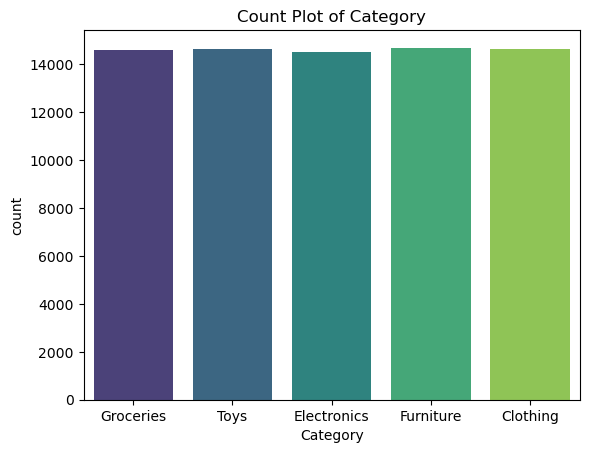

In [47]:
# Replace 'CategoricalColumn' with your categorical column name
sns.countplot(data=df, x='Category', palette='viridis')
plt.title('Count Plot of Category')
plt.show()

C:\Users\Asus\AppData\Local\Temp\ipykernel_16348\3281304465.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, y='Price', palette='pastel')


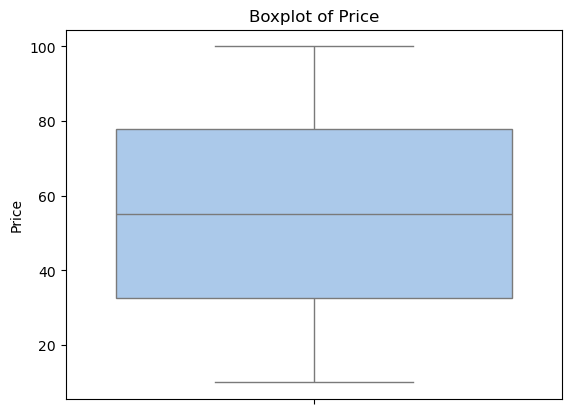

In [48]:
# Replace 'NumericalColumn' with your numerical column name
sns.boxplot(data=df, y='Price', palette='pastel')
plt.title('Boxplot of Price')
plt.show()

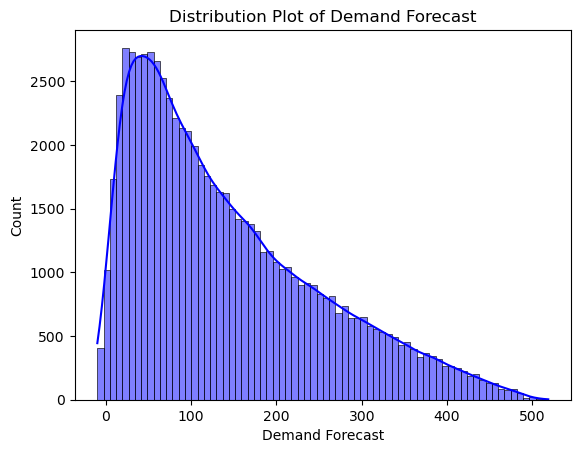

In [49]:
# Replace 'NumericalColumn' with your numerical column name
sns.histplot(df['Demand Forecast'], kde=True, color='blue')
plt.title('Distribution Plot of Demand Forecast')
plt.show()


C:\Users\Asus\AppData\Local\Temp\ipykernel_16348\1149737885.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(data=df, x='Region', y='Units Sold', palette='muted')


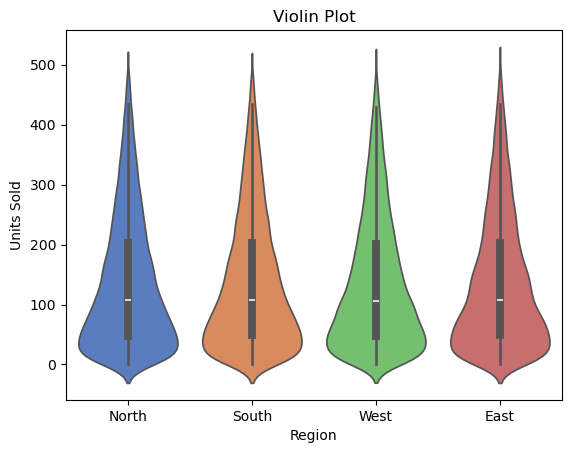

In [50]:
# Replace 'CategoricalColumn' and 'NumericalColumn' with respective column names
sns.violinplot(data=df, x='Region', y='Units Sold', palette='muted')
plt.title('Violin Plot')
plt.show()

C:\Users\Asus\AppData\Local\Temp\ipykernel_16348\3476547696.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=agg_data, x='Weather Condition', y='Inventory Level', palette='coolwarm')


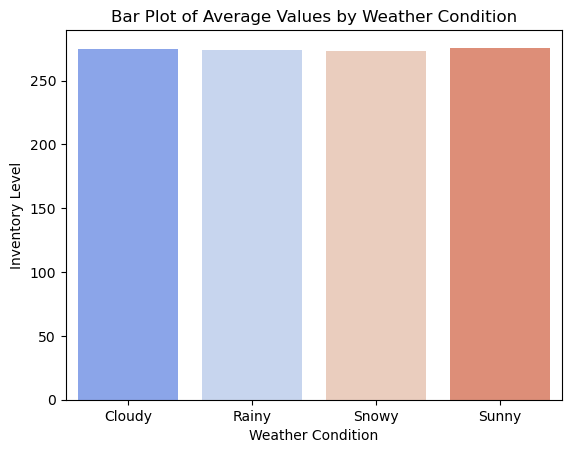

In [51]:
# Replace 'CategoricalColumn' and 'NumericalColumn' with respective column names
agg_data = df.groupby('Weather Condition')['Inventory Level'].mean().reset_index()
sns.barplot(data=agg_data, x='Weather Condition', y='Inventory Level', palette='coolwarm')
plt.title('Bar Plot of Average Values by Weather Condition')
plt.show()

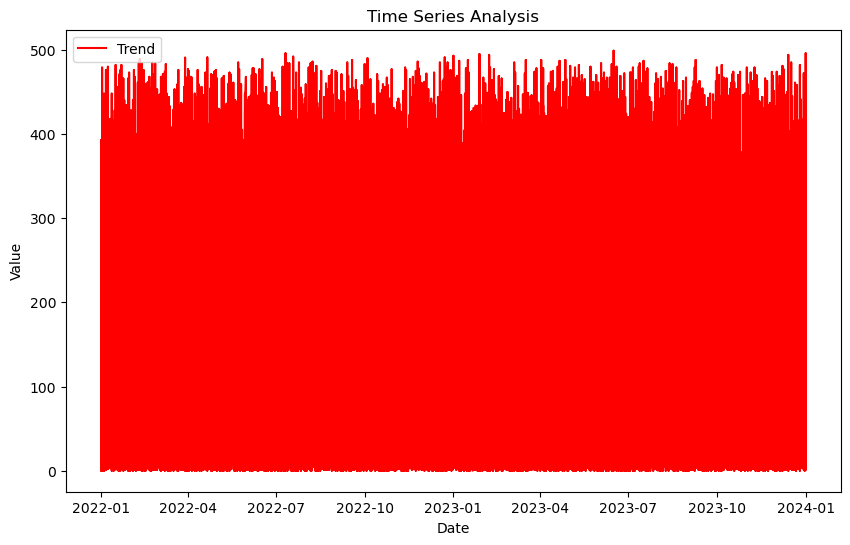

In [52]:
# Replace 'DateColumn' and 'NumericalColumn' with your columns
df['Date'] = pd.to_datetime(df['Date'])  # Ensure date format
df.sort_values('Date', inplace=True)

plt.figure(figsize=(10, 6))
plt.plot(df['Date'], df['Units Sold'], color='red', label='Trend')
plt.title('Time Series Analysis')
plt.xlabel('Date')
plt.ylabel('Value')
plt.legend()
plt.show()


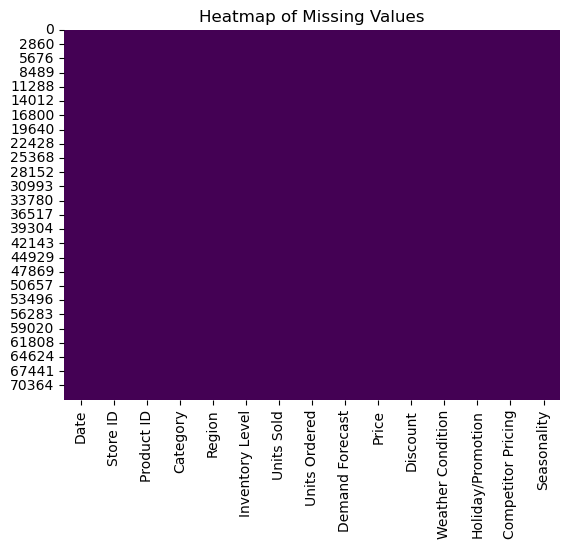

In [53]:
# Heatmap of null values
sns.heatmap(df.isnull(), cbar=False, cmap='viridis')
plt.title('Heatmap of Missing Values')
plt.show()


C:\Users\Asus\anaconda3\Lib\site-packages\matplotlib\collections.py:996: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


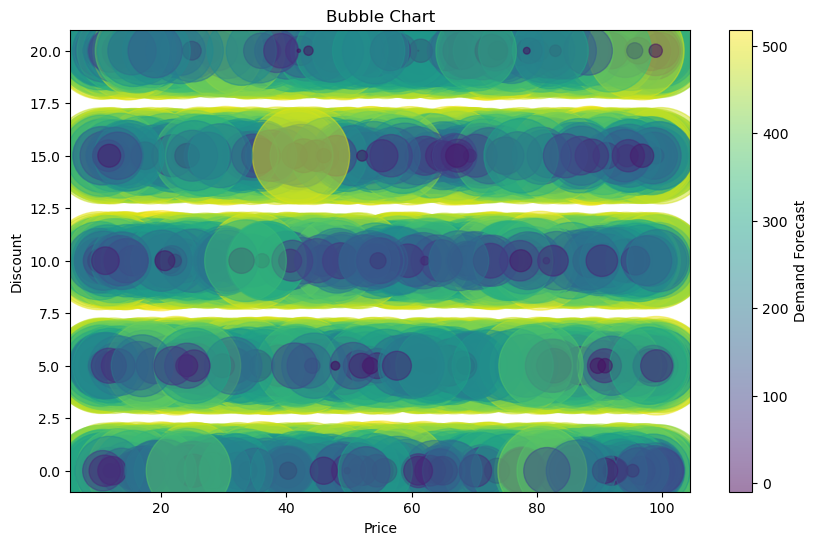

In [54]:
# Replace with appropriate columns
plt.figure(figsize=(10, 6))
plt.scatter(df['Price'], df['Discount'], 
            s=df['Demand Forecast']*10, alpha=0.5, c=df['Demand Forecast'], cmap='viridis')
plt.colorbar(label='Demand Forecast')
plt.title('Bubble Chart')
plt.xlabel('Price')
plt.ylabel('Discount')
plt.show()


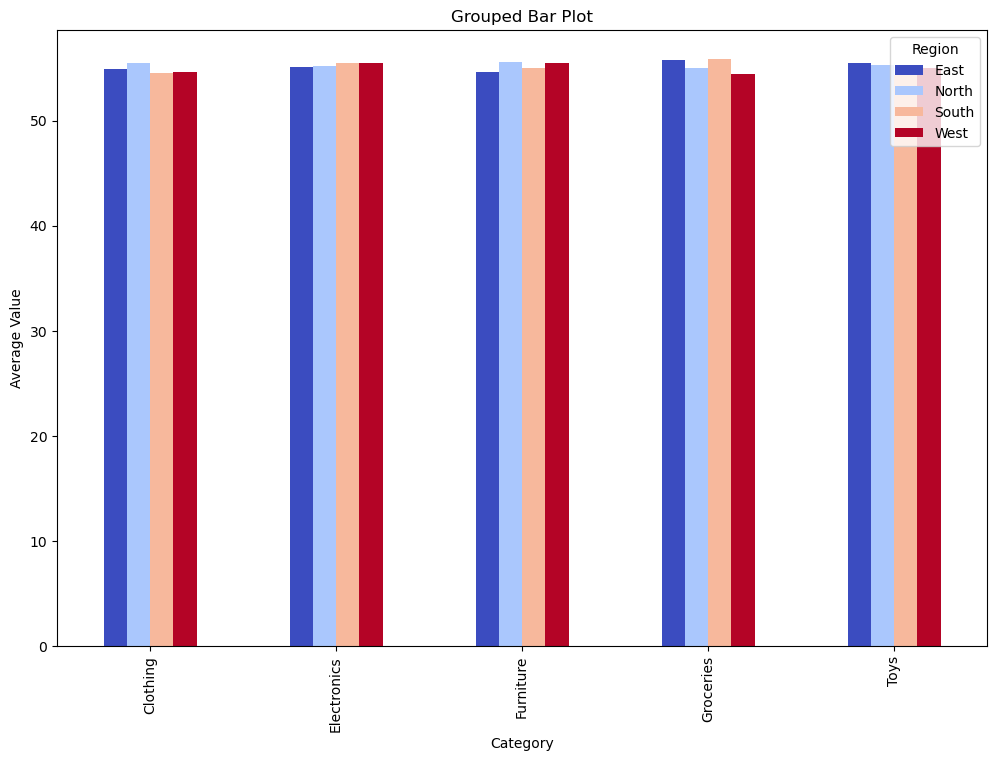

In [55]:
# Replace 'Category1', 'Category2', and 'ValueColumn' with respective column names
grouped_data = df.groupby(['Category', 'Region'])['Price'].mean().unstack()
grouped_data.plot(kind='bar', figsize=(12, 8), colormap='coolwarm')
plt.title('Grouped Bar Plot')
plt.ylabel('Average Value')
plt.show()


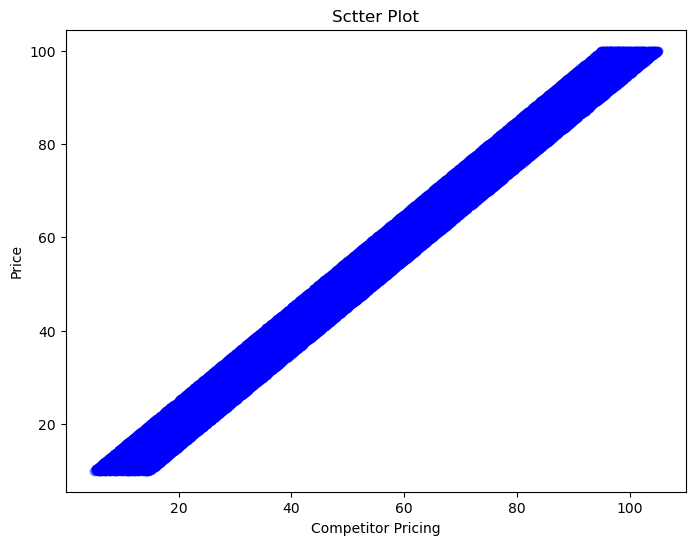

In [56]:
# representing the Competitor Pricing and price
plt.figure(figsize=(8, 6))
plt.scatter(df['Competitor Pricing'], df['Price'], c='blue', alpha=0.4)
plt.title('Sctter Plot')
plt.xlabel('Competitor Pricing')
plt.ylabel('Price')
plt.show()


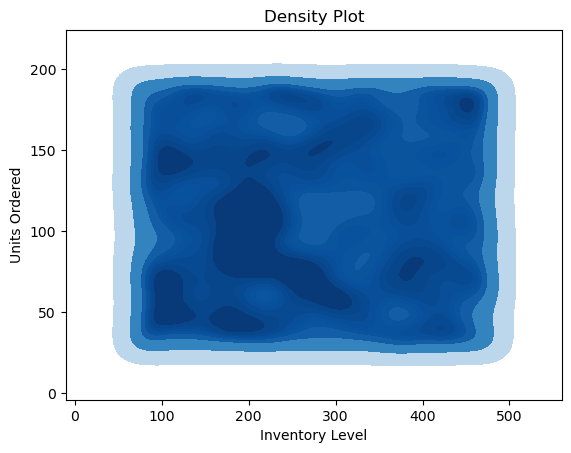

In [57]:
# Density plot
sns.kdeplot(x=df['Inventory Level'], y=df['Units Ordered'], cmap="Blues", fill=True)
plt.title('Density Plot')
plt.show()


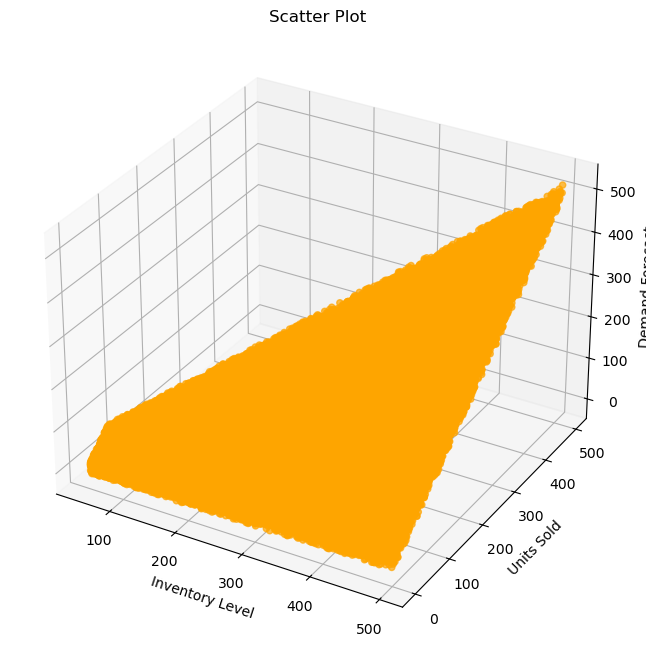

In [58]:
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(df['Inventory Level'], df['Units Sold'], df['Demand Forecast'], c='orange', alpha=0.7)
ax.set_title('Scatter Plot')
ax.set_xlabel('Inventory Level')
ax.set_ylabel('Units Sold')
ax.set_zlabel('Demand Forecast')
plt.show()


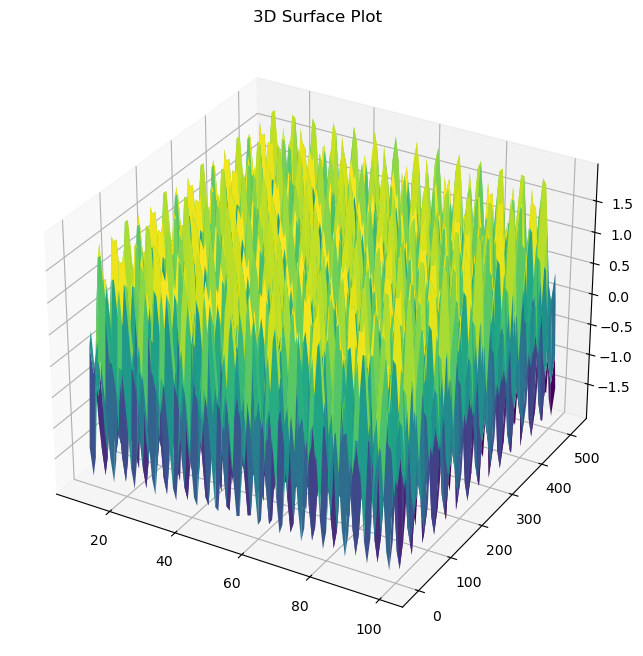

In [59]:
import numpy as np
x = np.linspace(df['Price'].min(), df['Price'].max(), 100)
y = np.linspace(df['Demand Forecast'].min(), df['Demand Forecast'].max(), 100)
X, Y = np.meshgrid(x, y)
Z = np.sin(X) + np.cos(Y)  

fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, Z, cmap='viridis')
ax.set_title('3D Surface Plot')
plt.show()


In [68]:
import plotly.express as px
fig = px.scatter_3d(df, x='Demand Forecast', y='Discount', z='Price', color='Category')
fig.update_layout(title='3D Scatter Plot', width=800, height=600)
fig.show()

In [70]:
fig = px.scatter_3d(df, x='Inventory Level', y='Units Ordered', z='Units Sold', color='Region')
fig.update_layout(title='3D Scatter Plot', width=800, height=600)
fig.show()

In [72]:
import plotly.graph_objects as go

fig = go.Figure(data=[go.Surface(z=df[['Price', 'Discount']].values)])
fig.update_layout(title='Interactive 3D Surface Plot', autosize=False, width=800, height=600)
fig.show()

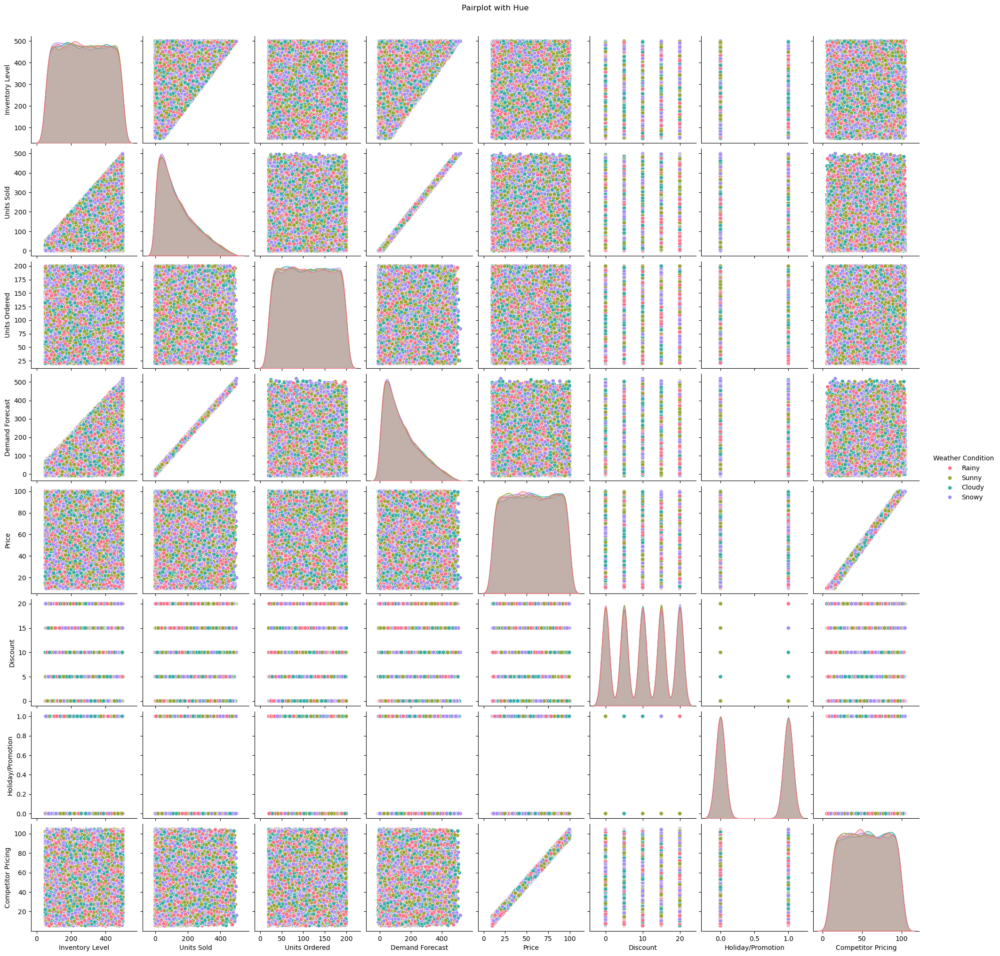

In [63]:
sns.pairplot(df, hue='Weather Condition', palette='husl')
plt.suptitle('Pairplot with Hue', y=1.02)
plt.show()

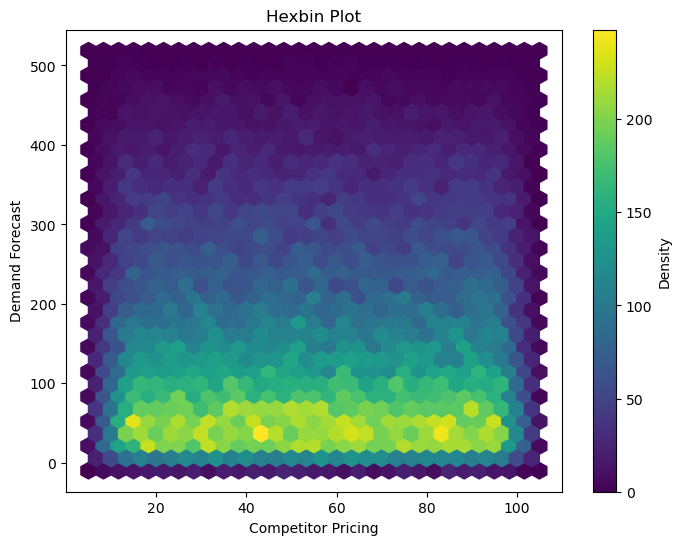

In [64]:
plt.figure(figsize=(8, 6))
plt.hexbin(df['Competitor Pricing'], df['Demand Forecast'], gridsize=30, cmap='viridis')
plt.colorbar(label='Density')
plt.title('Hexbin Plot')
plt.xlabel('Competitor Pricing')
plt.ylabel('Demand Forecast')
plt.show()


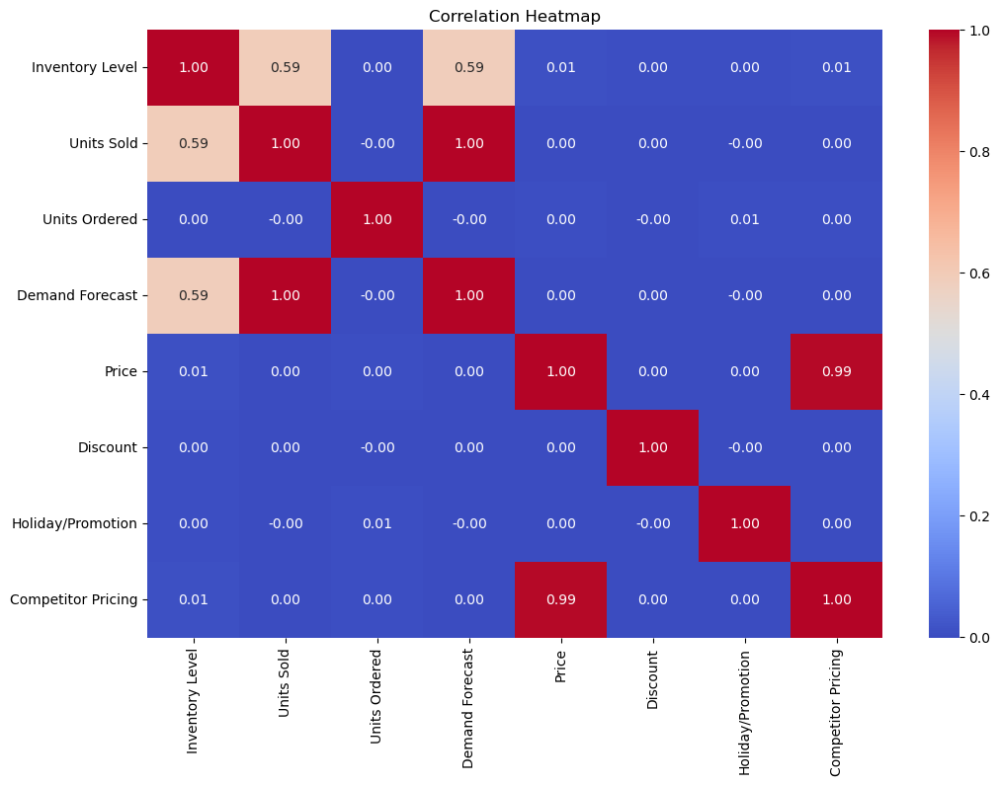

In [65]:

numeric_df = df.select_dtypes(include=[np.number])

# Correlation heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(numeric_df.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Heatmap')
plt.show()

# Data Preprocessing

In [67]:
# Convert categorical features to numerical (if any)
data = pd.get_dummies(data, drop_first=True)

NameError: name 'data' is not defined

In [ ]:
data

# Model Training

In [ ]:
# Model Train
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

# Define features and target
features = numeric_df.drop(columns=['Units Sold'])
target = numeric_df['Units Sold']

# Split the data
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Initialize and train the model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

In [ ]:
# Predict on the test set
y_pred = model.predict(X_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

In [ ]:
rmse

In [ ]:
from sklearn.model_selection import train_test_split
x=df.drop(columns=["Price"])
y = df["Price"]
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.3,random_state=42)

In [ ]:
from sklearn.ensemble import VotingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error

In [ ]:
st = df.groupby(["Store ID", 'Product ID']).size() # total number of of each product
st

In [ ]:
split_date = "2023-06-06"
train = df.loc[data.Date <= split_date].copy()
test = df.loc[data.Date > split_date].copy()

In [ ]:
len(train)

In [ ]:
len(test)

In [ ]:
train_float=train.select_dtypes(include="float64") #float64 columns
test_float=test.select_dtypes(include="float64") 

In [ ]:
train_float

In [ ]:
X_train,y_train=train_float,train["Inventory Level"]
X_test,y_test=test_float,test["Inventory Level"]

In [ ]:
X_train,y_train

In [ ]:
rmse

# Conclusion